# **U-Net**
## Imports and requierments

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch import nn, Tensor
import tifffile
import tensorflow as tf
import os
import numpy as np
from tensorflow import keras
import matplotlib.pyplot as plt
import time
from PIL import Image

# Common
import os
import keras
import numpy as np
from glob import glob
from tqdm import tqdm
from numpy import zeros
import tensorflow as tf
from numpy.random import randint

# Data
from tensorflow.image import resize
from tensorflow.keras.utils import load_img, img_to_array

# Data Viz
import matplotlib.pyplot as plt

# Model
from keras.layers import ReLU
from keras.models import Model
from keras.layers import Input
from keras.layers import Layer
from keras.layers import Conv2D
from keras.layers import Dropout
from keras.layers import LeakyReLU
from keras.layers import concatenate
from keras.layers import MaxPooling2D
from keras.layers import UpSampling2D
from keras.layers import ZeroPadding2D
from keras.layers import Conv2DTranspose
from keras.layers import BatchNormalization
from keras.optimizers import Adam

# Callbacks
from keras.callbacks import Callback

# Model Viz
from tensorflow.keras.utils import plot_model

from sklearn.model_selection import train_test_split

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


## Loading the images

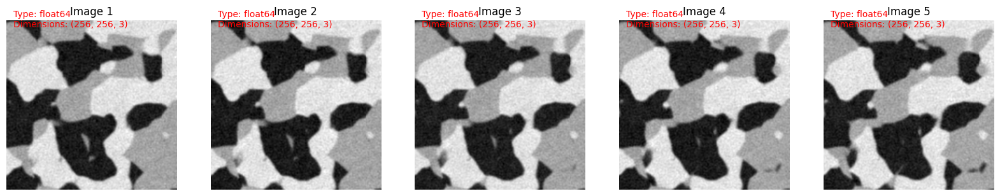

Shape: (500, 256, 256, 3)


In [2]:
# Define the target size for the images
target_size = (256, 256)

# Directory containing the images
directory_images = "/kaggle/input/dl-project-dtu/data"

# Range of image numbers
start_index = 1
end_index = 500

# Initialize an empty list to store images
images = []

# Calculate the cropping coordinates
crop_x_start = (501 - target_size[0]) // 2
crop_y_start = (501 - target_size[1]) // 2

# Loop through the range of image numbers
for i in range(start_index, end_index + 1):
    filename = f"SOCprist{i:04d}.tiff"
    image_path = os.path.join(directory_images, filename)

    # Load the image
    image = tifffile.imread(image_path)

    # Crop and resize the image
    image = image[crop_y_start:crop_y_start + target_size[1], crop_x_start:crop_x_start + target_size[0]]

    # Normalize the image data to the range [0, 1]
    image = (image - np.min(image)) / (np.max(image) - np.min(image))

    # Expand dimensions to (256, 256, 1) to indicate a single channel
    image = np.expand_dims(image, axis=-1)

    # Repeat the single channel to create a (256, 256, 3) image
    image = np.repeat(image, 3, axis=-1)

    images.append(image)


# Display the first 5 images in subplots

# Create subplots for displaying the first 5 images
fig, axes = plt.subplots(1, 5, figsize=(20, 6))


for i, image in enumerate(images[:5]):
    axes[i].imshow(image)
    axes[i].set_title(f"Image {i + 1}")
    axes[i].axis('off')

    image_type = image.dtype
    image_dimensions = image.shape
    axes[i].text(10, 10, f"Type: {image_type}\nDimensions: {image_dimensions}", color='red', fontsize=10)

plt.show()

# Convert list of images into a Numpy Array
images = np.array(images)
print(f'Shape: {images.shape}')

## Loading the labels

In [3]:
import os
import numpy as np
import matplotlib.pyplot as plt
import tifffile
from tensorflow.keras.utils import to_categorical

# Define the target size for labels
target_size = (256, 256)

# Directory containing the labels
directory_labels = "/kaggle/input/dl-project-dtu/labels"

# Range of label numbers
start_index = 1
end_index = 500

# Initialize an empty list to store labels
labels = []
original_labels = []

# Calculate the cropping coordinates
crop_x_start = (501 - target_size[0]) // 2
crop_y_start = (501 - target_size[1]) // 2

# Loop through the range of label numbers
for idx in range(start_index, end_index + 1):
    filename = f"slice__{idx:03d}.tif"
    label_path = os.path.join(directory_labels, filename)

    # Load the label
    label = tifffile.imread(label_path)

    # Crop and resize the label
    label = label[crop_y_start:crop_y_start + target_size[1], crop_x_start:crop_x_start + target_size[0]]

    # Normalize the label data to the range [0, 1]
    label = (label - np.min(label)) / (np.max(label) - np.min(label))

    # Check shape of labels
    height, width = label.shape
    
    #apend original labels to list
    original_labels.append(label)

    # Create one-hot encoding for the labels
    one_hot = np.zeros((height, width, 3), dtype=np.uint8)
    class_1 = np.zeros((height, width), dtype=np.uint8)
    class_05 = np.zeros((height, width), dtype=np.uint8)
    class_0 = np.zeros((height, width), dtype=np.uint8)

    for x in range(width):
        for y in range(height):
            if label[x,y] == 1:
                class_1[x, y] = 1
                class_05[x, y] = 0
                class_0[x, y] = 0
            elif 0.3 < label[x,y] < 0.6:
                class_1[x,y] = 0
                class_05[x, y] = 1
                class_0[x, y] = 0
            elif label[x,y] == 0:
                class_1[x,y] = 0
                class_05[x, y] = 0
                class_0[x, y] = 1
                
    one_hot[:,:,0] = class_1
    one_hot[:,:,1] = class_05
    one_hot[:,:,2] = class_0
    labels.append(np.reshape(np.array(one_hot), (256, 256, 3)))

# Convert list of labels into a Numpy Array
labels = np.array(labels)

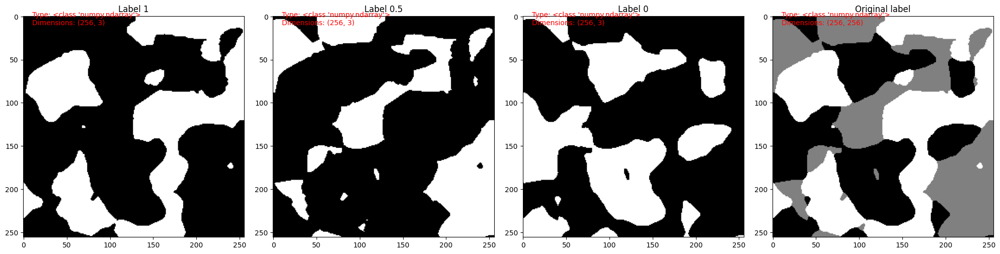

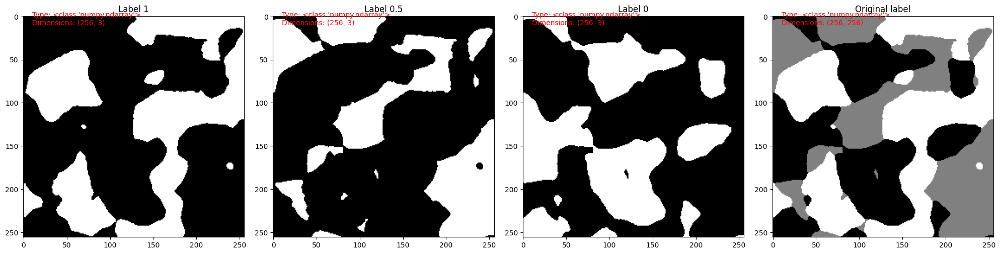

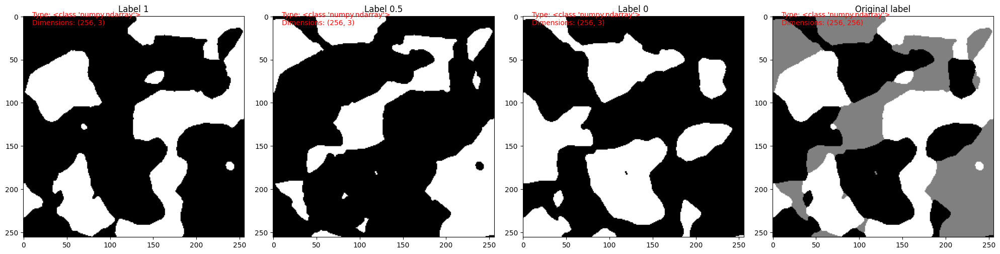

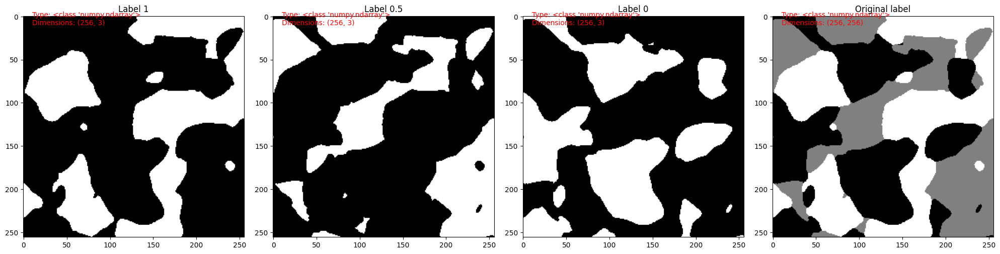

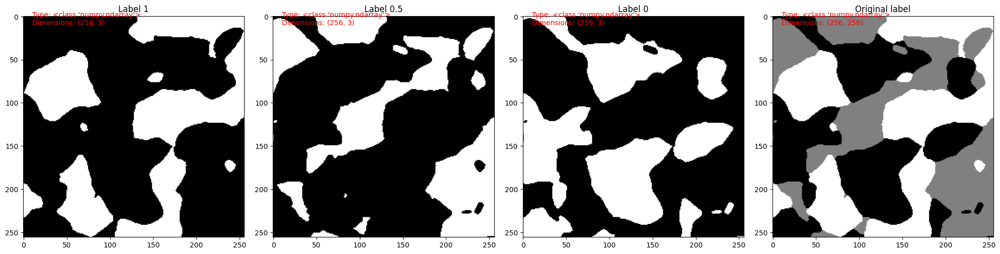

In [4]:
for i, idx in enumerate(labels[:5]):
    # Plot the three channels of the labels
    fig, axs = plt.subplots(1, 4, figsize=(20, 6))

    # Plot on the first subplot
    axs[0].imshow(idx[:,:,0], cmap='gray')
    axs[0].set_title('Label 1')

    # Plot on the second subplot
    axs[1].imshow(idx[:,:,1], cmap='gray')
    axs[1].set_title('Label 0.5')

    # Plot on the third subplot
    axs[2].imshow(idx[:,:,2], cmap='gray')
    axs[2].set_title('Label 0')
    
    # Plot the whole label
    axs[3].imshow(original_labels[i], cmap='gray')
    axs[3].set_title('Original label')

    # Adjust layout to prevent clipping of titles
    plt.tight_layout()

    #label_type = label.dtype
    label_dimensions = idx[0].shape
    axs[0].text(10, 10, f"Type: {type(idx[0])}\nDimensions: {label_dimensions}", color='red', fontsize=10)
    label_dimensions = idx[1].shape
    axs[1].text(10, 10, f"Type: {type(idx[1])}\nDimensions: {label_dimensions}", color='red', fontsize=10)
    label_dimensions = idx[2].shape
    axs[2].text(10, 10, f"Type: {type(idx[2])}\nDimensions: {label_dimensions}", color='red', fontsize=10)
    label_dimensions = original_labels[i].shape
    axs[3].text(10, 10, f"Type: {type(original_labels[i])}\nDimensions: {label_dimensions}", color='red', fontsize=10)
    
    # Show the plot
    plt.show()

## Functions

In [5]:
def dice_coefficient(y_test, y_pred):
        intersection = tf.reduce_sum(y_test * y_pred)
        union = tf.reduce_sum(y_test) + tf.reduce_sum(y_pred)
        return (2.0 * intersection) / (union + tf.keras.backend.epsilon())

In [6]:
def show_predictions(model, n_images=5):
    for i in range(n_images):
        plt.figure(figsize=(10,8))

        id = randint(len(test_images))
        image, mask = test_images[id], test_masks[id]
        pred_mask = model.predict(image[np.newaxis,...])[0]

        plt.subplot(1,3,1)
        show_image(image, title='Original Image')

        plt.subplot(1,3,2)
        show_image(mask, title='Original Mask')

        plt.subplot(1,3,3)
        show_image(pred_mask, title='Predicted Mask')

        plt.show()

        print(f'DICE Coefficient {iou(mask,pred_mask)}')

## U-Net Architecture

In [7]:
dropout_rate = 0.3
def first_model(input_shape, num_classes):
    inputs = Input(input_shape)

    # Contracting Path
    conv1 = Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    conv1 = Dropout(dropout_rate)(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, (3, 3), activation='relu', padding='same')(pool1)
    conv2 = Dropout(dropout_rate)(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, (3, 3), activation='relu', padding='same')(pool2)
    conv3 = Dropout(dropout_rate)(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same')(pool3)
    conv4 = Dropout(dropout_rate)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

    # Bottleneck
    conv5 = Conv2D(256, (3, 3), activation='relu', padding='same')(pool4)

    # Expanding Path
    up4 = concatenate([UpSampling2D(size=(2, 2))(conv5), conv4], axis=-1)
    conv6 = Conv2D(128, (3, 3), activation='relu', padding='same')(up4)

    up5 = concatenate([UpSampling2D(size=(2, 2))(conv6), conv3], axis=-1)
    conv7 = Conv2D(128, (3, 3), activation='relu', padding='same')(up5)

    up6 = concatenate([UpSampling2D(size=(2, 2))(conv7), conv2], axis=-1)
    conv8 = Conv2D(128, (3, 3), activation='relu', padding='same')(up6)

    up7 = concatenate([UpSampling2D(size=(2, 2))(conv8), conv1], axis=-1)
    conv9 = Conv2D(64, (3, 3), activation='relu', padding='same')(up7)

    # Output layer
    output = Conv2D(num_classes, (1, 1), activation='softmax')(conv9)

    model = Model(inputs=[inputs], outputs=[output])

    return model

    def forward(self, x):
        out = self.conv1(x)
        out = self.pool1(out)

        out = self.conv2(out)
        out = self.pool2(out)

        out = self.conv3(out)

        out = self.up4(out)
        out = self.conv4(out)

        out = self.up5(out)
        out = self.conv5(out)

        out = self.output(out)
        return out

with tf.device("/GPU:0"):
    # Create the model
    model = first_model((256, 256, 3), 3)  # assuming input images are 128x128 with 3 channels

    # Compile the model
    custom_loss = tf.keras.losses.BinaryCrossentropy(
    from_logits=False,
    label_smoothing=0.0,
    axis=-1,
    name='binary_crossentropy'
      )

    model.compile(optimizer='adam', loss=custom_loss, metrics=[dice_coefficient])

    model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 64)         1792      ['input_1[0][0]']             
                                                                                                  
 dropout (Dropout)           (None, 256, 256, 64)         0         ['conv2d[0][0]']              
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 128, 128, 64)         0         ['dropout[0][0]']             
 D)                                                                                           

In [8]:
#plot_model(model, to_file='unet_v3.png', show_shapes=True, show_layer_names=True)

In [9]:
pip install visualkeras

  Obtaining dependency information for aggdraw>=1.3.11 from https://files.pythonhosted.org/packages/da/05/8912c901a3965ec7117d6cc33eaec3888c717611f72ce69d8be62a01d149/aggdraw-1.3.18-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.7/993.7 kB 22.2 MB/s eta 0:00:0000:01
Note: you may need to restart the kernel to use updated packages.


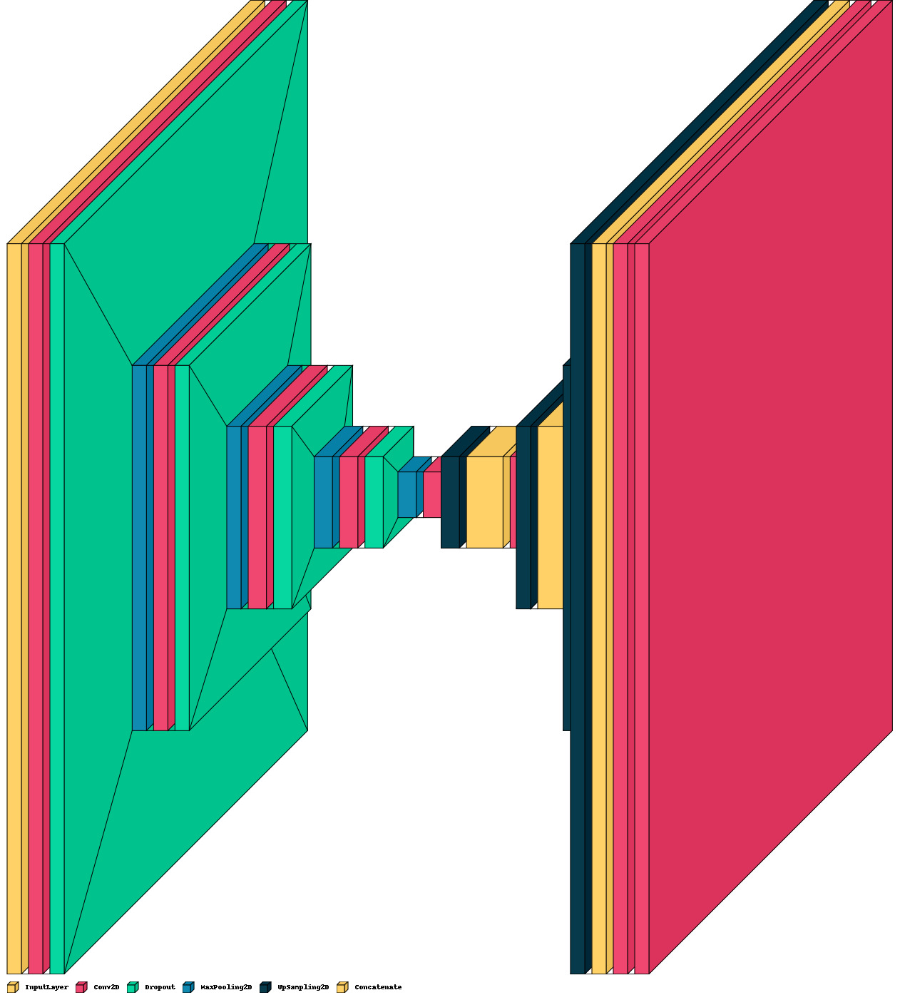

In [10]:
import visualkeras
from IPython.display import Image

visualkeras.layered_view(model, to_file='/kaggle/working/unet_model.png',legend=True)

# Display model structure
Image(filename='/kaggle/working/unet_model.png')

In [11]:
print(f"Number of images: {len(images)}")
print(f"Number of labels: {len(labels)}")
print(f"Shape of images: {images.shape}")
print(f"Shape of labels: {labels.shape}")

Number of images: 500
Number of labels: 500
Shape of images: (500, 256, 256, 3)
Shape of labels: (500, 256, 256, 3)


## Divide into train, validation and test
At the beginning we divided the dataset into train, validation and test to optimize the hyperparameters.

Once this was done, we merged train and validation into a single training set. Using the hold-out method and varying the volume of training data we tested the performance of the model when using different sizes of training set.

In [14]:
train_size = 0.9 # Change train_size to do dynamic training
x_train, x_test, y_train, y_test = train_test_split(images, labels, test_size=1 - train_size, random_state=42)
#x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, test_size=0.25, random_state=42) 

In [15]:
class DiceCoefficientCallback(Callback):
    def __init__(self, x_val, y_val):
        super(DiceCoefficientCallback, self).__init__()
        self.x_val = x_val
        self.y_val = y_val
        self.train_dice_values = []
        self.val_dice_values = []

    def dice_coefficient(self, y_true, y_pred):
        y_true = tf.cast(y_true, tf.float32)  # Convert to float32
        y_pred = tf.cast(y_pred, tf.float32)  # Convert to float32
        intersection = tf.reduce_sum(y_true * y_pred)
        union = tf.reduce_sum(y_true) + tf.reduce_sum(y_pred)
        return (2.0 * intersection + 1e-7) / (union + 1e-7)

    def on_epoch_end(self, epoch, logs=None):
        # For training set
        train_pred = self.model.predict(self.model.x_train)
        train_dice = self.dice_coefficient(self.model.y_train, train_pred)
        self.train_dice_values.append(train_dice)

        # For validation set
        val_pred = self.model.predict(self.x_val)
        val_dice = self.dice_coefficient(self.y_val, val_pred)
        self.val_dice_values.append(val_dice)

        print(f'\nEpoch {epoch + 1}, Training Dice Coefficient: {train_dice}, Validation Dice Coefficient: {val_dice}')

    def on_train_end(self, logs=None):
        train_mean = np.mean(self.train_dice_values)
        train_std = np.std(self.train_dice_values)
        train_median = np.median(self.train_dice_values)
        train_percentiles = np.percentile(self.train_dice_values, [25, 75])

        val_mean = np.mean(self.val_dice_values)
        val_std = np.std(self.val_dice_values)
        val_median = np.median(self.val_dice_values)
        val_percentiles = np.percentile(self.val_dice_values, [25, 75])

        print("\nTraining Dice Coefficient Statistics:")
        print(f"Mean: {train_mean}, Std: {train_std}, Median: {train_median}, Percentiles: {train_percentiles}")

        print("\nValidation Dice Coefficient Statistics:")
        print(f"Mean: {val_mean}, Std: {val_std}, Median: {val_median}, Percentiles: {val_percentiles}")

## Training

In [16]:
model.x_train = x_train
model.y_train = y_train

# Create an instance of the custom callback by providing the validation data.
dice_callback = DiceCoefficientCallback(x_val=x_test, y_val=y_test)
dice_callback.model = model  # Set the model reference in the callback

with tf.device("/GPU:0"):
    history = model.fit(x_train, y_train, batch_size=32, epochs=35, validation_data=(x_test, y_test), callbacks=[dice_callback])

Epoch 1/35


2023-12-20 16:23:18.193164: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


2/2 [==============================] - 0s 206ms/step

Epoch 1, Training Dice Coefficient: 0.5496705770492554, Validation Dice Coefficient: 0.5548946261405945
15/15 [==============================] - 59s 2s/step - loss: 0.5640 - dice_coefficient: 0.4501 - val_loss: 0.4528 - val_dice_coefficient: 0.5578
Epoch 2/35
2/2 [==============================] - 0s 210ms/step

Epoch 2, Training Dice Coefficient: 0.5949045419692993, Validation Dice Coefficient: 0.597834050655365
15/15 [==============================] - 18s 1s/step - loss: 0.4863 - dice_coefficient: 0.5438 - val_loss: 0.4019 - val_dice_coefficient: 0.5980
Epoch 3/35
2/2 [==============================] - 0s 216ms/step

Epoch 3, Training Dice Coefficient: 0.6198566555976868, Validation Dice Coefficient: 0.629138708114624
15/15 [==============================] - 21s 1s/step - loss: 0.3606 - dice_coefficient: 0.6446 - val_loss: 0.3775 - val_dice_coefficient: 0.6333
Epoch 4/35
2/2 [==============================] - 0s 222ms/step

Epoch 

In [17]:
# Make predictions on the test set
test_predictions = model.predict(x_test)

2/2 [==============================] - 0s 217ms/step


Here we plot the misclassified areas together with the original image, the true label and the predicted label, and it can be seen that it is mainly the edges separating the 3 classes that are misclassified.

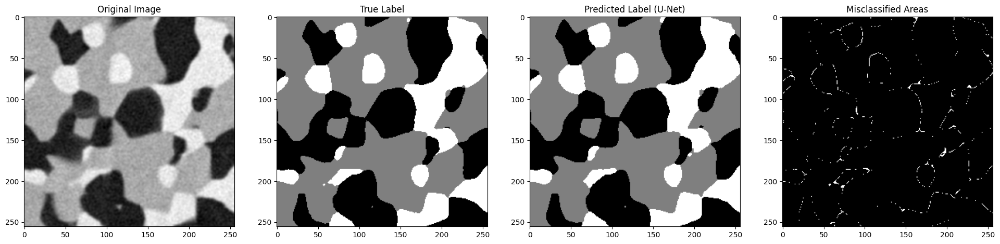

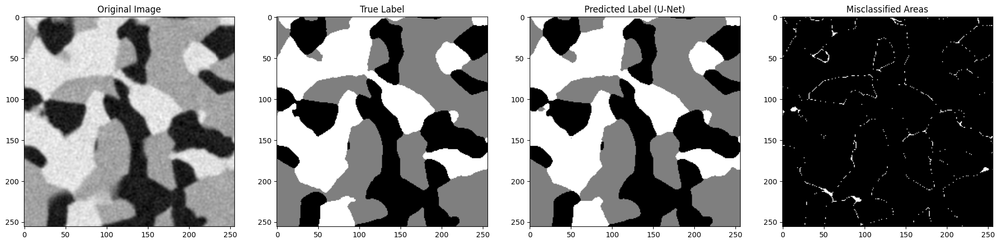

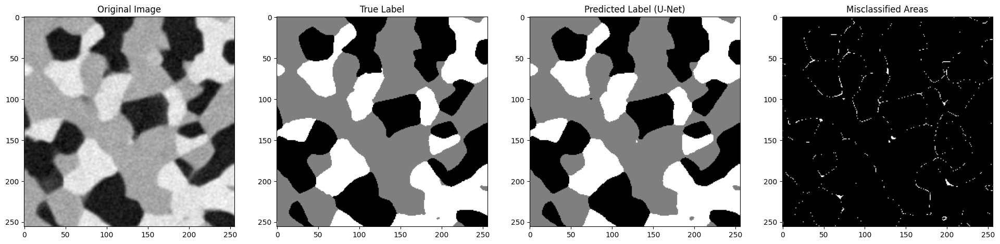

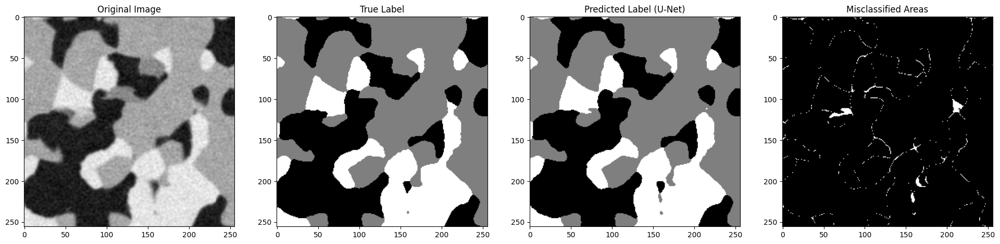

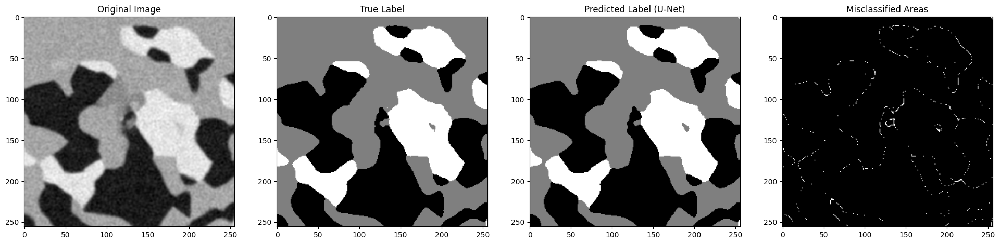

...

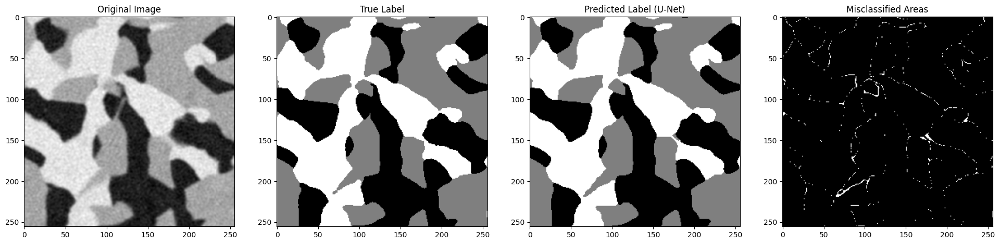

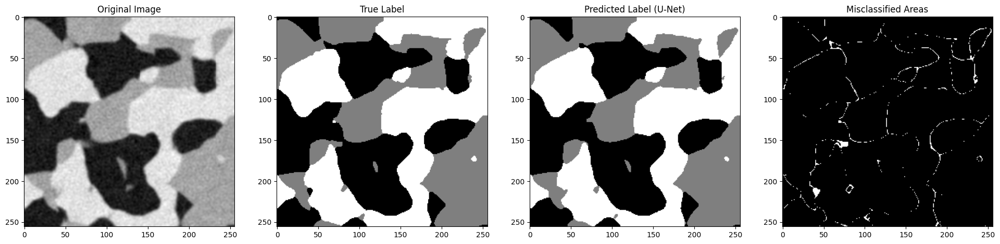

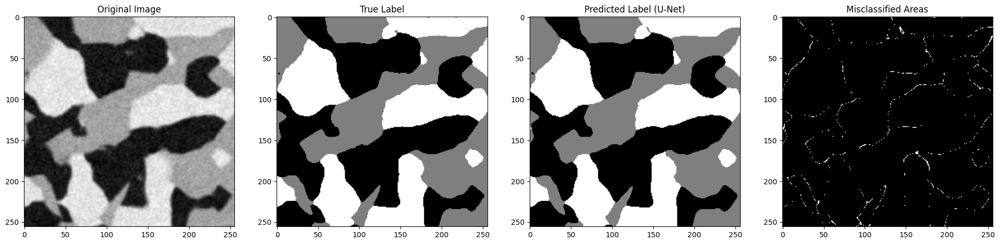

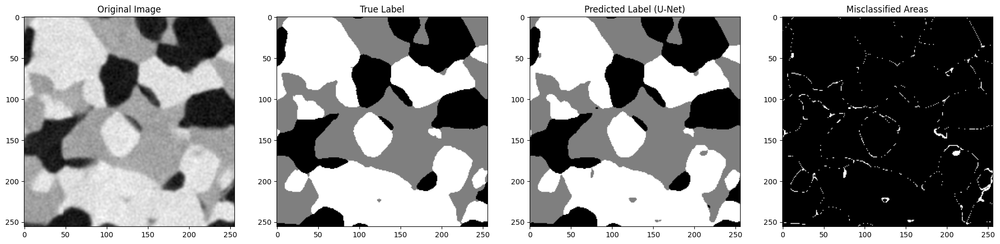

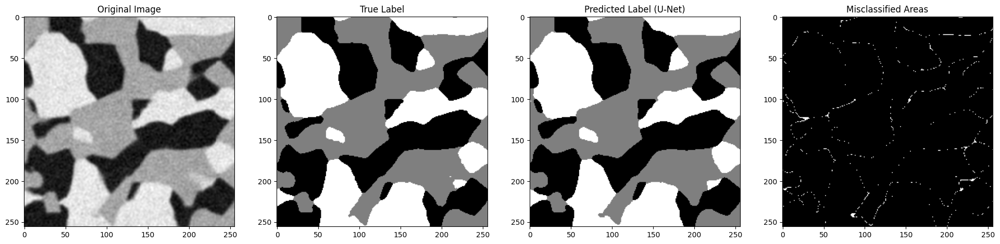

In [18]:
with tf.device("/GPU:0"):
    for i in range(len(x_test)):
        # Predict the label for the chosen image
        image = x_test[i]
        image = np.expand_dims(image, axis=0)  # Expand dimensions for prediction

        # Remove the added dimensions for plotting
        image = np.squeeze(image)
        prediction = np.squeeze(test_predictions[i])

        # Plot the original image, the true label, and the predicted label
        plt.figure(figsize=(24, 6))

        plt.subplot(1, 4, 1)
        plt.imshow(image)
        plt.title('Original Image')

        plt.subplot(1, 4, 2)
        plt.imshow(np.argmax(y_test[i], axis=-1), cmap='gray_r')
        plt.title('True Label')

        plt.subplot(1, 4, 3)
        plt.imshow(np.argmax(prediction, axis=-1), cmap='gray_r')
        plt.title('Predicted Label (U-Net)')
        
        plt.subplot(1, 4, 4)
        misclassified_areas = np.where(np.argmax(y_test[i], axis=-1) != np.argmax(prediction, axis=-1), 1, 0)
        plt.imshow(misclassified_areas, cmap='gray')
        plt.title('Misclassified Areas')

        plt.show()


## Probability map
We ploted the probabilities of the 3 classes with different colors.

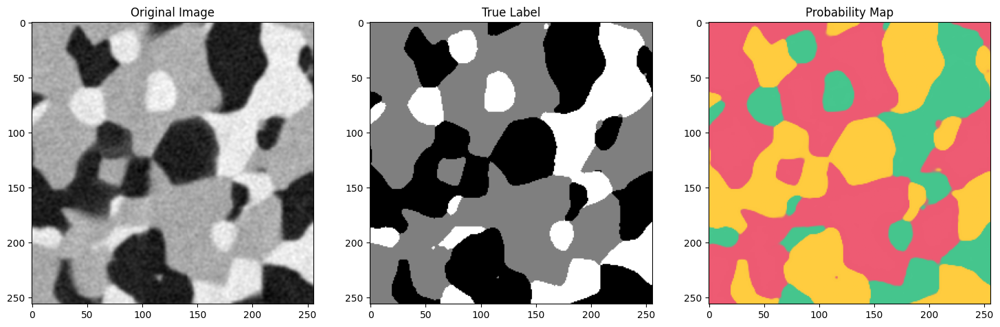

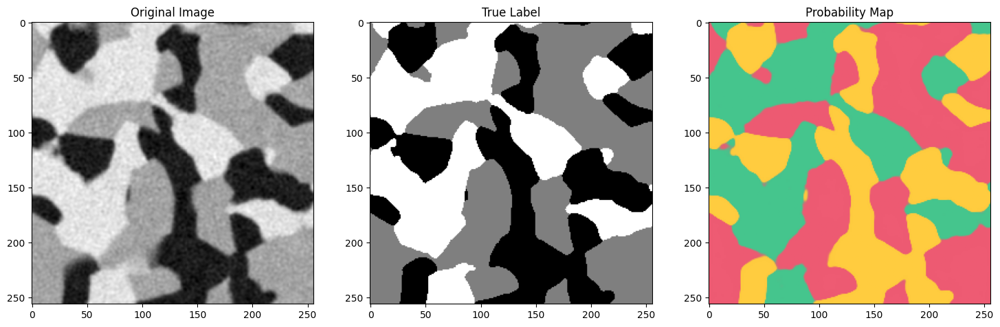

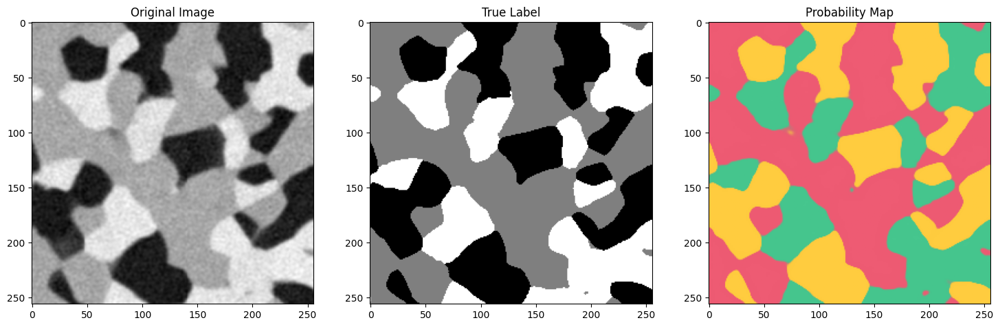

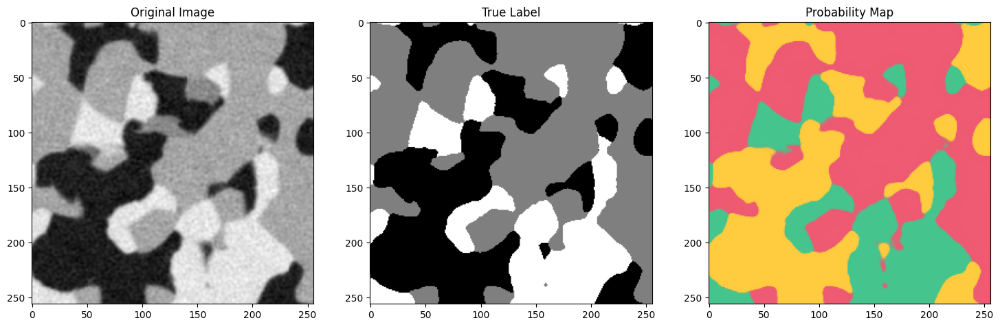

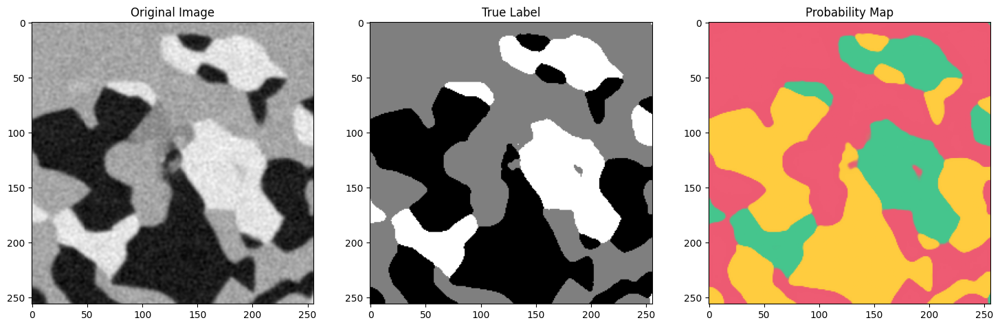

...

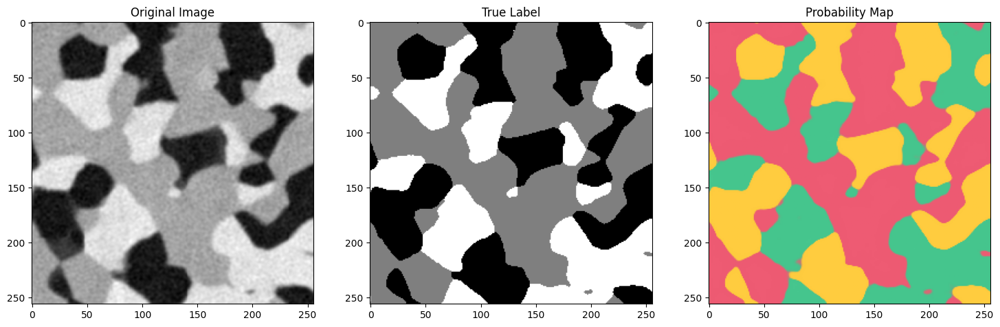

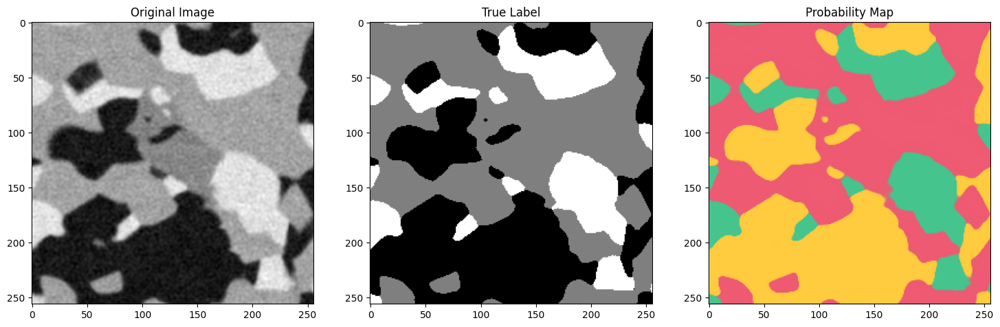

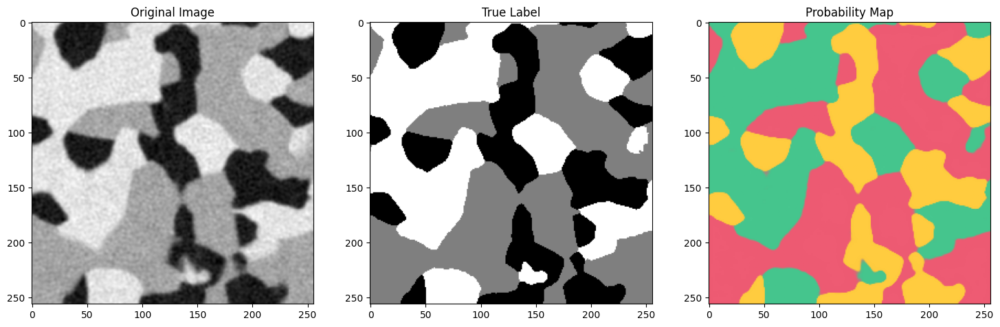

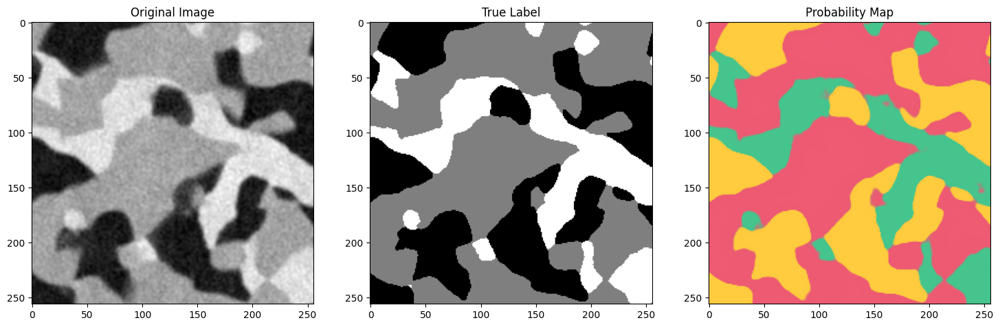

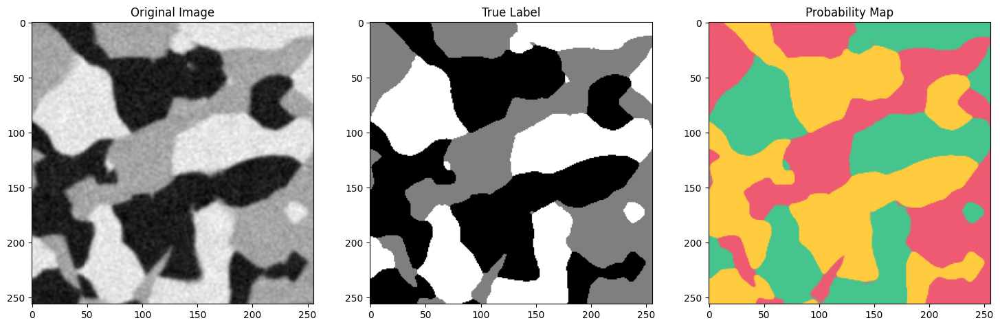

In [20]:
# Visualization of probability map
for i in range(len(x_test)):
    image = x_test[i]
    image = np.expand_dims(image, axis=0)  # Add batch dimension

    # Remove the added dimensions for plotting
    image = np.squeeze(image)
    prediction = np.squeeze(test_predictions[i])

    # Colors for each class
    class_colors = [
        [70, 198, 142],   # Class 1 (Green)
        [238, 91, 115],   # Class 2 (Pink)
        [255, 204, 63]    # Class 3 (Yellow)
    ]

    # Creating a probability map
    probability_map = np.zeros((prediction.shape[0], prediction.shape[1], 3), dtype=np.uint8)

    for class_index in range(prediction.shape[-1]):
        # Assigning color based on class index and probability
        color = np.array(class_colors[class_index])[np.newaxis, np.newaxis, :]
        probability_map += (np.expand_dims(prediction[:, :, class_index], axis=-1) * color).astype(np.uint8)


    # Normalize the probability map to [0, 1] for visualization
    probability_map = probability_map.astype(np.float32) / 255.0


    # Plot the original image, true label, and probability map
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title('Original Image')

    plt.subplot(1, 3, 2)
    plt.imshow(np.argmax(y_test[i], axis=-1), cmap='gray_r')
    plt.title('True Label')

    plt.subplot(1, 3, 3)
    plt.imshow(probability_map)
    plt.title('Probability Map')

    plt.show()

    if i == 10:
        break


For better visualisation, we separated the 3 classes into 3 different images. Here we can see that some edges seem blurred because the probabilities are lower.

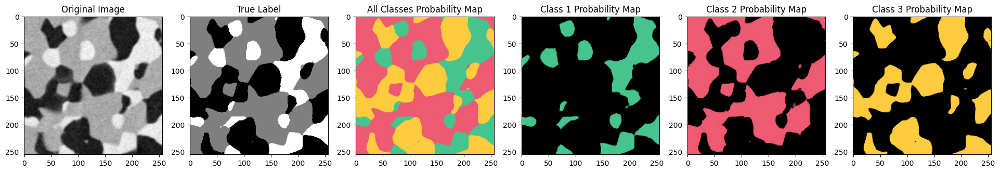

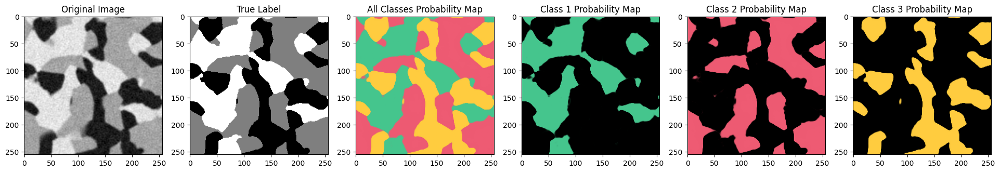

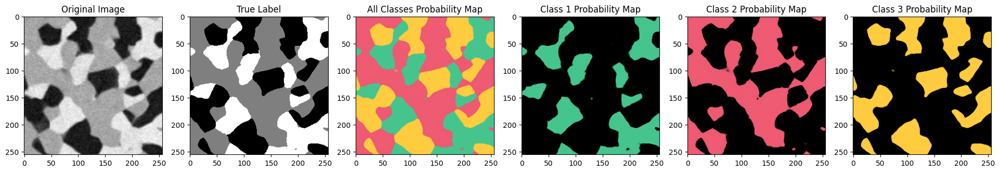

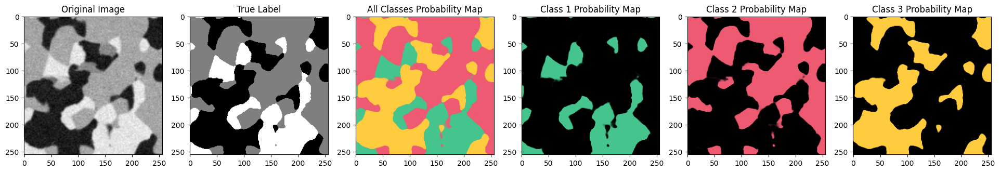

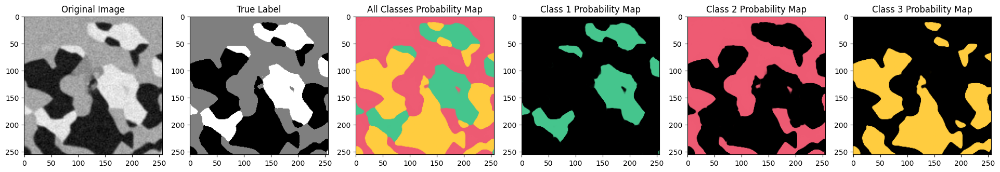

...

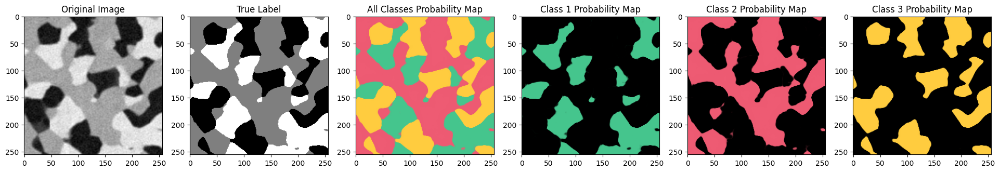

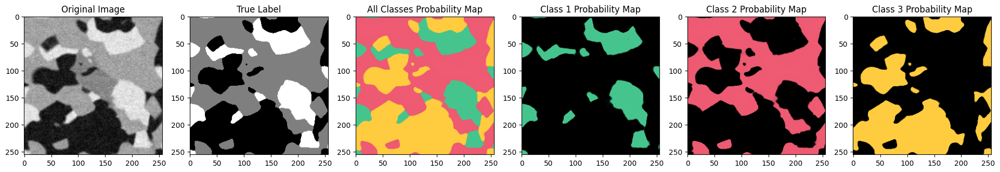

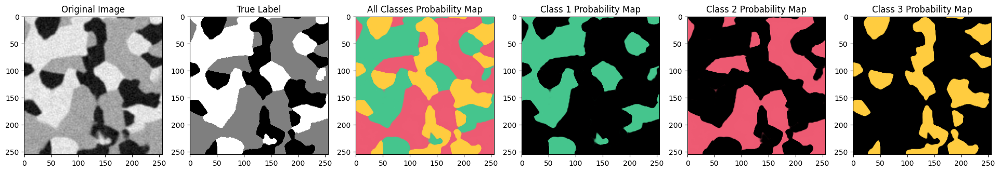

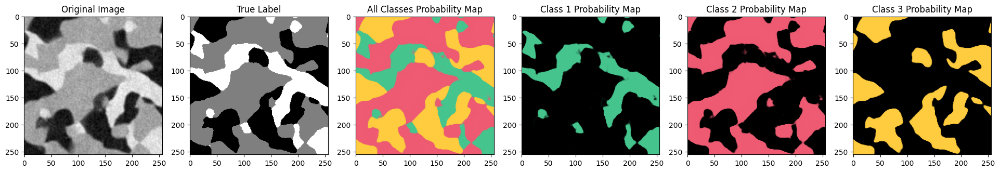

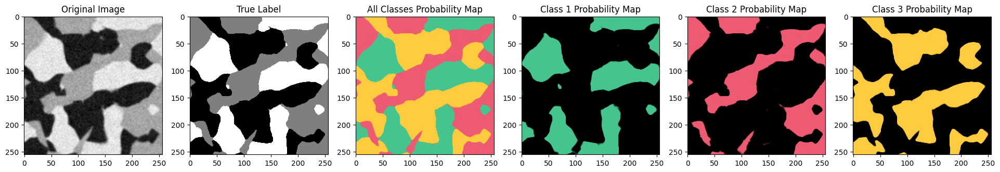

In [21]:
num_classes = 3
# Visualization of probability maps
for i in range(len(x_test)):
    image = x_test[i]
    image = np.expand_dims(image, axis=0)  # Add batch dimension

    # Remove the added dimensions for plotting
    image = np.squeeze(image)
    prediction = np.squeeze(test_predictions[i])

    # Colors for each class
    class_colors = [
        [70, 198, 142],   # Class 1 (Green)
        [238, 91, 115],   # Class 2 (Pink)
        [255, 204, 63]    # Class 3 (Yellow)
    ]

    # Create subplots for the original image, true label, and probability maps for each class
    plt.figure(figsize=(24, 4))

    # Plot the original image
    plt.subplot(1, 6, 1)
    plt.imshow(image)
    plt.title('Original Image')

    # Plot the true label
    plt.subplot(1, 6, 2)
    plt.imshow(np.argmax(y_test[i], axis=-1), cmap='gray_r')
    plt.title('True Label')

    # Plot the probability map for all classes together
    probability_map_all = np.zeros((prediction.shape[0], prediction.shape[1], 3), dtype=np.uint8)
    for class_index in range(num_classes):
        color = np.array(class_colors[class_index])[np.newaxis, np.newaxis, :]
        probability_map_all += (np.expand_dims(prediction[:, :, class_index], axis=-1) * color).astype(np.uint8)
    probability_map_all = probability_map_all.astype(np.float32) / 255.0

    plt.subplot(1, 6, 3)
    plt.imshow(probability_map_all)
    plt.title('All Classes Probability Map')

    # Plot the probability map for each class
    for class_index in range(num_classes):
        probability_map_class = np.zeros((prediction.shape[0], prediction.shape[1], 3), dtype=np.uint8)
        color = np.array(class_colors[class_index])[np.newaxis, np.newaxis, :]
        probability_map_class += (np.expand_dims(prediction[:, :, class_index], axis=-1) * color).astype(np.uint8)
        probability_map_class = probability_map_class.astype(np.float32) / 255.0

        plt.subplot(1, 6, class_index + 4)
        plt.imshow(probability_map_class)
        plt.title(f'Class {class_index + 1} Probability Map')

    plt.show()
    
    if i == 10:
        break


## Dice score  and loss per epoch

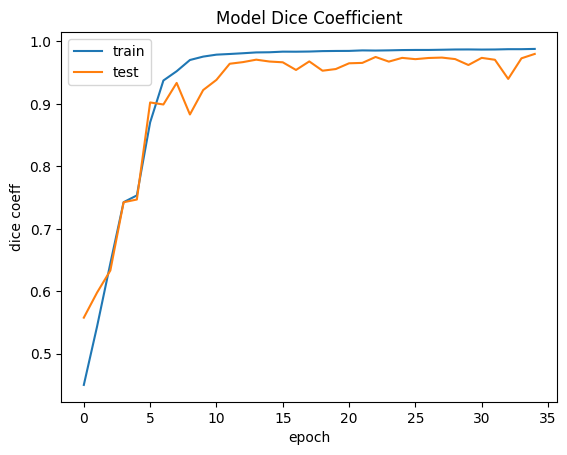

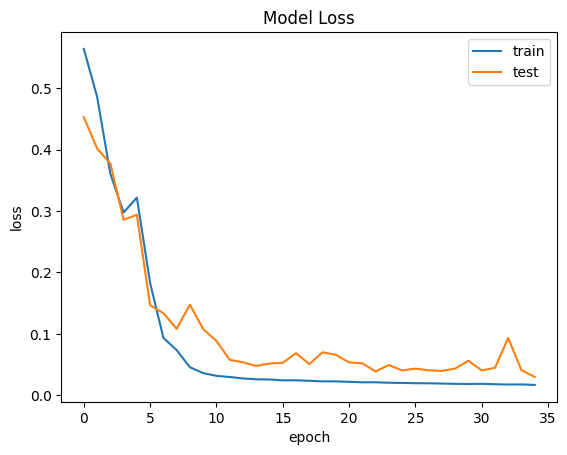

In [22]:
# 32 batch, 15 epochs
plt.plot(history.history['dice_coefficient'])
plt.plot(history.history['val_dice_coefficient'])
plt.title('Model Dice Coefficient')
plt.ylabel('dice coeff')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper right')
plt.show()

In [23]:
del model